# Exploring the prompts




In [1]:
!pip install diffusers==0.11.1
!pip install -q accelerate transformers ftfy bitsandbytes==0.35.0 natsort safetensors xformers

import torch
from diffusers import StableDiffusionPipeline

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 524.9/524.9 kB 7.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 11.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 251.2/251.2 kB 4.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.5/7.5 MB 34.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.5/62.5 MB 28.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 68.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 167.0/167.0 MB 8.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 98.2 MB/s eta 0:00:00


In [2]:
pipe = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", torch_dtype=torch.float16)
pipe = pipe.to("cuda")

text_encoder/pytorch_model.fp16.safetensors not found


Fetching 29 files:   0%|          | 0/29 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


In [3]:
pipe.enable_attention_slicing()
pipe.enable_xformers_memory_efficient_attention()

In [4]:
seed = 777

In [5]:
from PIL import Image

def grid_img(imgs, rows=1, cols=3, scale=1):
  assert len(imgs) == rows * cols

  w, h = imgs[0].size
  w, h = int(w*scale), int(h*scale)

  grid = Image.new('RGB', size=(cols*w, rows*h))
  grid_w, grid_h = grid.size

  for i, img in enumerate(imgs):
      img = img.resize((w,h), Image.ANTIALIAS)
      grid.paste(img, box=(i%cols*w, i//cols*h))
  return grid

### Subject / object


  0%|          | 0/50 [00:00<?, ?it/s]

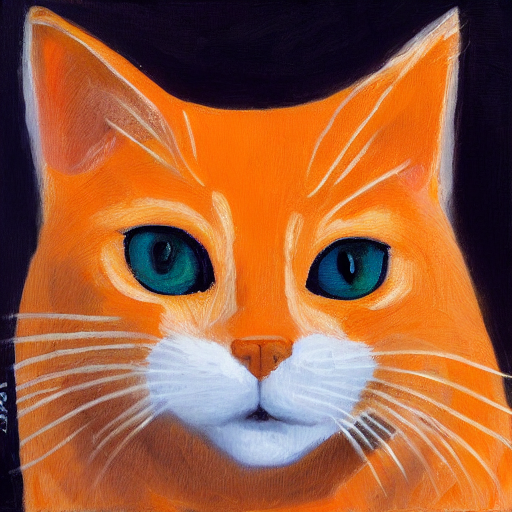

In [6]:
prompt = 'an orange cat'

generator = torch.Generator('cuda').manual_seed(seed)
img = pipe(prompt, generator=generator).images[0]
img

### Action and location


  0%|          | 0/50 [00:00<?, ?it/s]

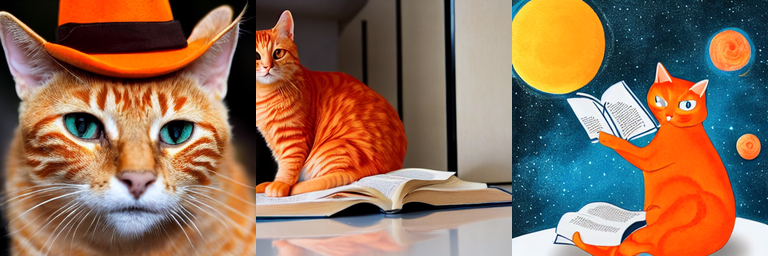

In [7]:
prompt = ['an orange cat wearing a hat',
          'an orange cat reading a book in the kitchen',
          'an orange cat reading a book in space']

generator = torch.Generator('cuda').manual_seed(seed)
imgs = pipe(prompt, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompt), scale=0.5)
grid

### Type


  0%|          | 0/50 [00:00<?, ?it/s]

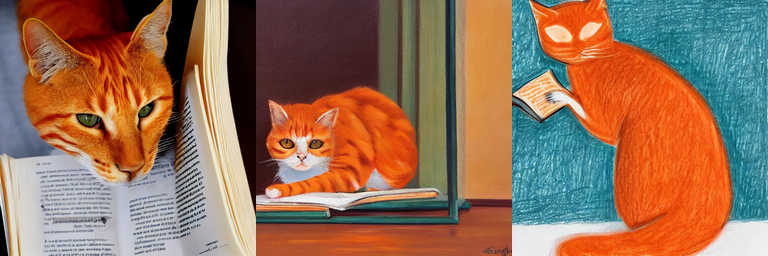

In [8]:
prompt = ["photo of an orange cat reading a book in the kitchen",
          "oil painting of an orange cat reading a book in the kitchen",
          "drawing of an orange cat reading a book in the kitchen"]

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompt, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompt), scale=0.5)
grid

#### Useful keywords


['orange cat reading a book in space, oil painting', 'orange cat reading a book in space, digital painting', 'orange cat reading a book in space, underwater steampunk']


  0%|          | 0/50 [00:00<?, ?it/s]

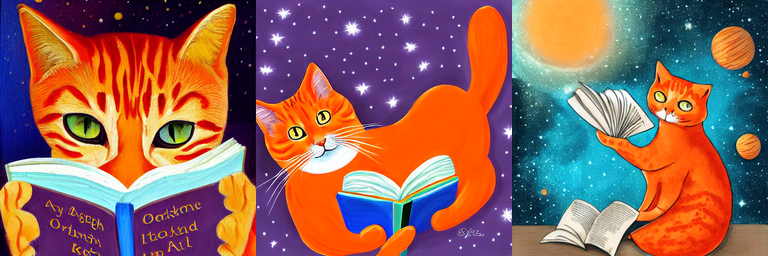

In [9]:
base = 'orange cat reading a book in space'

m_ = [', oil painting',
      ', digital painting',
      ', underwater steampunk']

prompts = []

for m in m_:
  prompts.append(base + m)

print(prompts)

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompts, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompts), scale=0.5)
grid

### Style


['orange cat reading a book in space, Modernist', 'orange cat reading a book in space, impressionist', 'orange cat reading a book in space, realistic']


  0%|          | 0/50 [00:00<?, ?it/s]

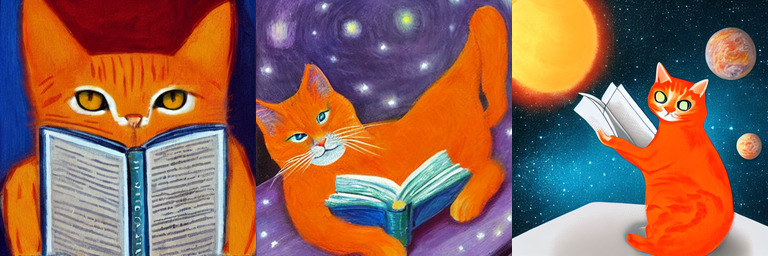

In [10]:
base = "orange cat reading a book in space"

m_ = [", Modernist",
      ", impressionist",
      ", realistic"]

prompts = []

for m in m_:
  prompts.append(base + m)

print(prompts)

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompts, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompts), scale=0.5)
grid

### Colors


['a photograph of an orange cat reading a book in space, realistic, purple', 'a photograph of an orange cat reading a book in space, realistic, red colors', 'a photograph of an orange cat reading a book in space, realistic, black and white']


  0%|          | 0/50 [00:00<?, ?it/s]

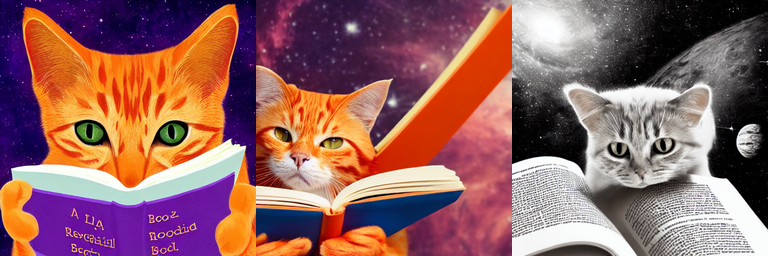

In [11]:
base = "a photograph of an orange cat reading a book in space, realistic"

m_ = [", purple",
      ", red colors",
      ", black and white"]

prompts = []

for m in m_:
  prompts.append(base + m)

print(prompts)

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompts, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompts), scale=0.5)
grid

### Artist


['a painting of an orange cat reading a book in space, realistic, by Van Gogh', 'a painting of an orange cat reading a book in space, realistic, by Sandro Botticelli', 'a painting of an orange cat reading a book in space, realistic, by Monet', 'a painting of an orange cat reading a book in space, realistic, by Da Vinci']


  0%|          | 0/50 [00:00<?, ?it/s]

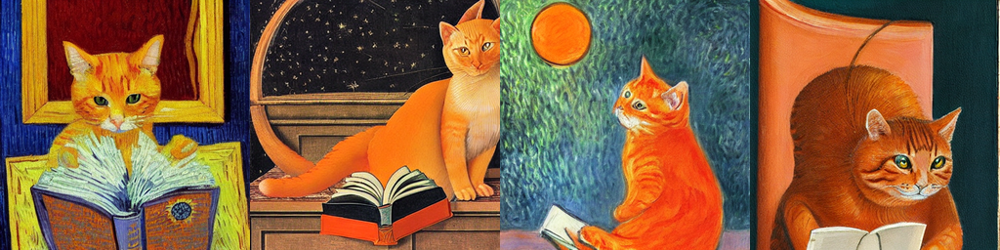

In [12]:
base = "a painting of an orange cat reading a book in space, realistic"

m_ = [", by Van Gogh",
      ", by Sandro Botticelli",
      ", by Monet",
      ", by Da Vinci"]

prompts = []

for m in m_:
  prompts.append(base + m)

print(prompts)

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompts, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompts), scale=0.5)
grid

### Resolution


['a futuristic city on another planet at dawn, unreal engine', 'a futuristic city on another planet at dawn, sharp focus', 'a futuristic city on another planet at dawn, vray']


  0%|          | 0/50 [00:00<?, ?it/s]

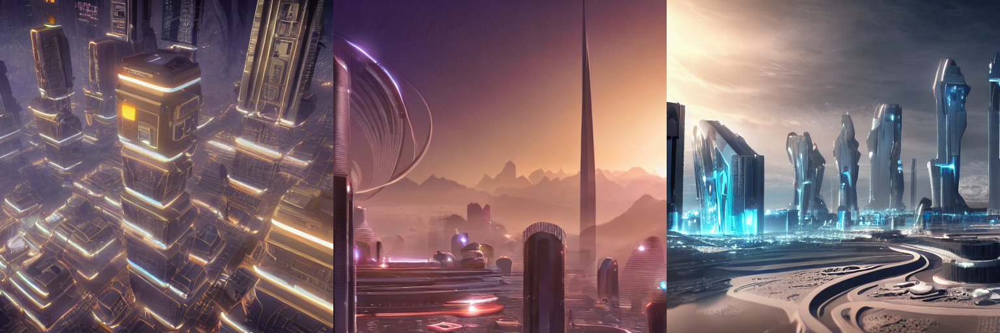

In [13]:
base = "a futuristic city on another planet at dawn"

m_ = [", unreal engine",
      ", sharp focus",
      ", vray"]

prompts = []

for m in m_:
  prompts.append(base + m)

print(prompts)

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompts, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompts))
grid

### Site


['an orange cat reading a book in space, realistic, unsplash', 'an orange cat reading a book in space, realistic, pixabay', 'an orange cat reading a book in space, realistic, pixiv']


  0%|          | 0/50 [00:00<?, ?it/s]

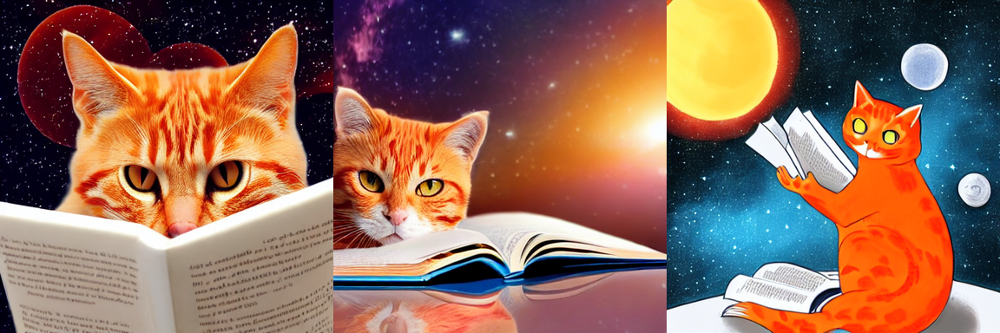

In [14]:
base = "an orange cat reading a book in space, realistic"

m_ = [", unsplash",
      ", pixabay",
      ", pixiv"]

prompts = []

for m in m_:
  prompts.append(base + m)

print(prompts)

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompts, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompts), scale=0.75)
grid

### Other attributes




#### Ilumination

['photograph of an orange cat reading a book in space, realistic, unsplash, cinematic lighting', 'photograph of an orange cat reading a book in space, realistic, unsplash, rim lighting', 'photograph of an orange cat reading a book in space, realistic, unsplash, sunset']


  0%|          | 0/50 [00:00<?, ?it/s]

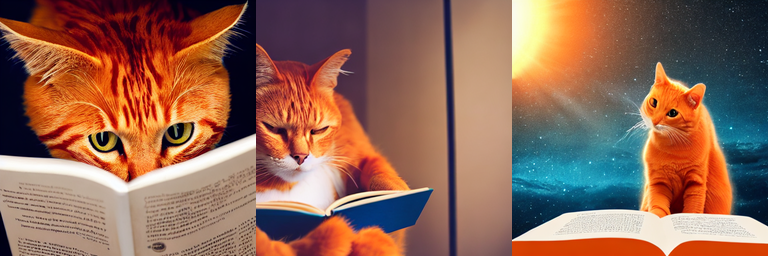

In [15]:
base = "photograph of an orange cat reading a book in space, realistic, unsplash"

m_ = [", cinematic lighting",
      ", rim lighting",
      ", sunset"]

prompts = []

for m in m_:
  prompts.append(base + m)

print(prompts)

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompts, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompts), scale=0.5)
grid

#### Others

['photo of an orange cat reading a book in space, realistic, unsplash, stunningly beautiful, award winning photo, tilt-shift', 'photo of an orange cat reading a book in space, realistic, dramatic', 'photo of an orange cat reading a book in space, realistic, low angle shot']


  0%|          | 0/50 [00:00<?, ?it/s]

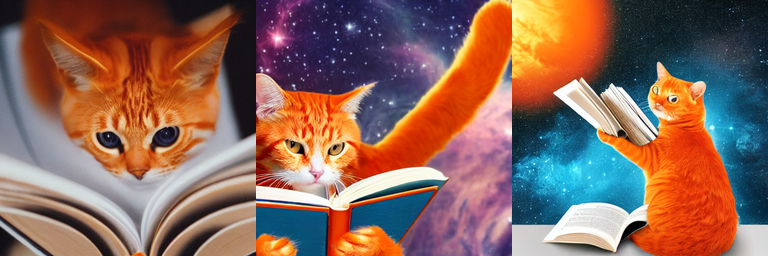

In [16]:
base = "photo of an orange cat reading a book in space, realistic"

m_ = [", unsplash, stunningly beautiful, award winning photo, tilt-shift",
      ", dramatic",
      ", low angle shot"]

prompts = []

for m in m_:
  prompts.append(base + m)

print(prompts)

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompts, generator=generator).images

grid = grid_img(imgs, rows=1, cols=len(prompts), scale=0.5)
grid

## Negative prompts


  0%|          | 0/50 [00:00<?, ?it/s]

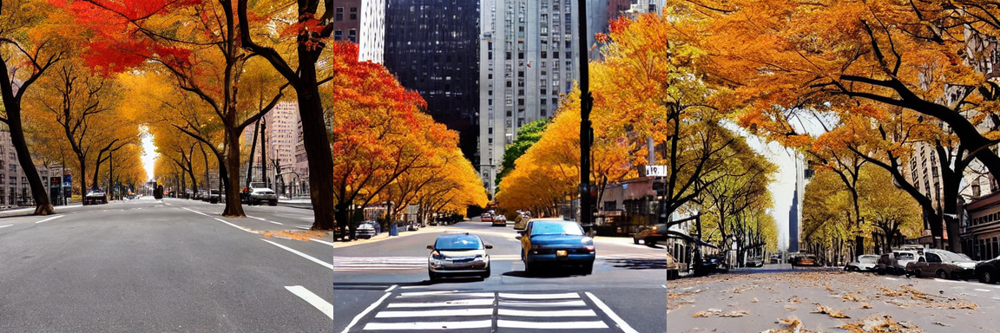

In [17]:
prompt = "photo of autumn in new york without cars"
num_imgs = 3

imgs = pipe(prompt,
             num_images_per_prompt=num_imgs,
             generator=torch.Generator("cuda").manual_seed(seed)).images

grid = grid_img(imgs, rows=1, cols=num_imgs, scale=0.75)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

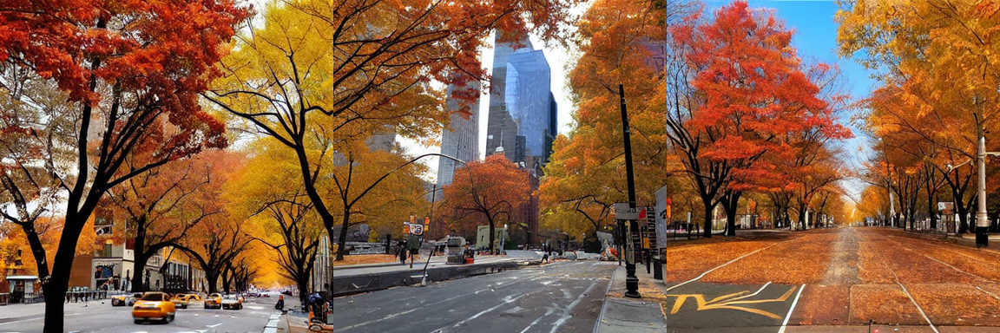

In [18]:
prompt = "photo of autumn in new york without cars"
neg_prompt = "cars"
num_imgs = 3

imgs = pipe(prompt,
             num_images_per_prompt=num_imgs,
             negative_prompt = neg_prompt).images

grid = grid_img(imgs, rows=1, cols=num_imgs, scale=0.75)
grid

### Universal negative prompt


  0%|          | 0/50 [00:00<?, ?it/s]

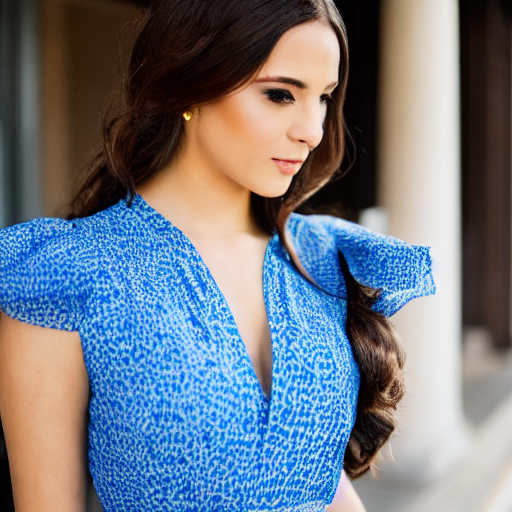

In [19]:
prompt = "a young woman, front face, wearing a blue dress, natural light"
neg_prompt = "bad anatomy, ugly, deformed, desfigured, distorted face, poorly drawn hands, poorly drawn face, poorly drawn feet"

img = pipe(prompt,
           negative_prompt = neg_prompt,
          generator=torch.Generator("cuda").manual_seed(seed)).images[0]
img

  0%|          | 0/50 [00:00<?, ?it/s]

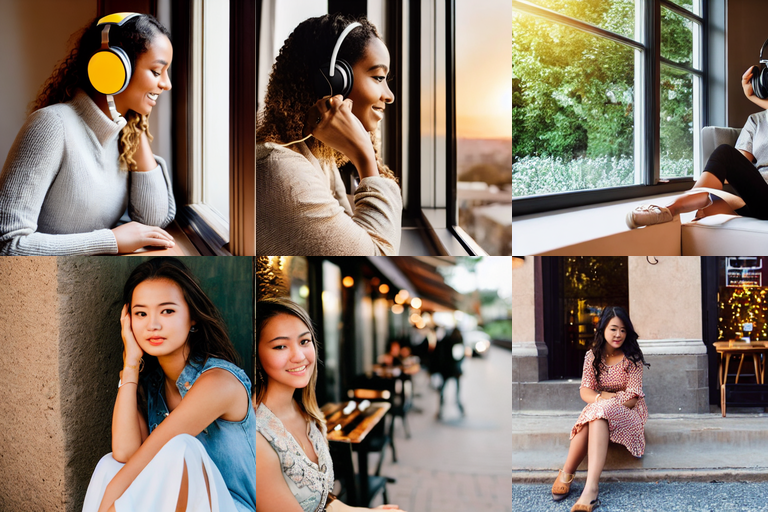

In [20]:
prompt = ["photo of young woman sitting by window with headphones, realistic, golden hour, rim lighting",
          "a young female, highlights in hair, sitting outside restaurant, brown eyes, wearing a dress, side light"]

neg_prompt = ["ugly, deformed, disfigured, bad anatomy"] * len(prompt)
num_imgs = 3

seed = 777
generator = torch.Generator("cuda").manual_seed(seed)

imgs = pipe(prompt,
             num_images_per_prompt=num_imgs,
             negative_prompt = neg_prompt,
             generator=generator).images

grid = grid_img(imgs, rows=len(prompt), cols=num_imgs, scale=0.5)
grid

## Stable Diffusion v2

In [21]:
sd21 = StableDiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-2-1", torch_dtype=torch.float16)

text_encoder/pytorch_model.fp16.safetensors not found


Fetching 22 files:   0%|          | 0/22 [00:00<?, ?it/s]

In [22]:
from diffusers import EulerAncestralDiscreteScheduler

sd21.scheduler = EulerAncestralDiscreteScheduler.from_config(sd21.scheduler.config)
print(sd21.scheduler)

sd21 = sd21.to("cuda")
sd21.enable_attention_slicing()

EulerAncestralDiscreteScheduler {
  "_class_name": "EulerAncestralDiscreteScheduler",
  "_diffusers_version": "0.11.1",
  "beta_end": 0.012,
  "beta_schedule": "scaled_linear",
  "beta_start": 0.00085,
  "clip_sample": false,
  "num_train_timesteps": 1000,
  "prediction_type": "v_prediction",
  "set_alpha_to_one": false,
  "skip_prk_steps": true,
  "steps_offset": 1,
  "trained_betas": null
}



  0%|          | 0/35 [00:00<?, ?it/s]

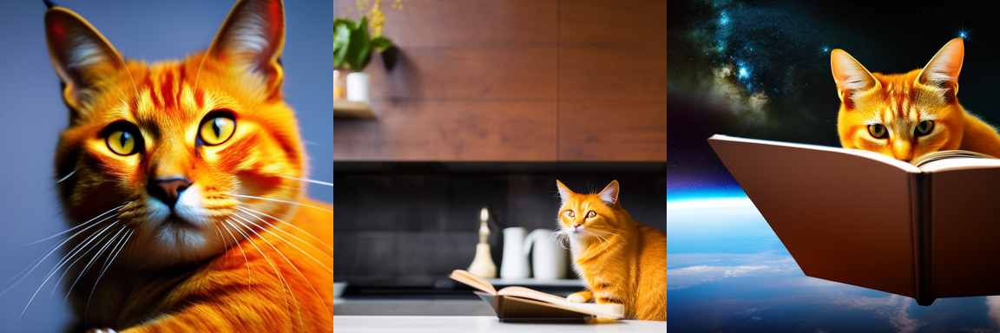

In [23]:
prompt = ["an orange cat ",
          "an orange cat reading a book in the kitchen",
          "an orange cat reading a book in space"]

neg_prompt = ["bad anatomy, ugly, deformed, desfigured, distorted face, poorly drawn hands, poorly drawn face, poorly drawn feet"] * len(prompt)

imgs = sd21(prompt,
          negative_prompt=neg_prompt,
          generator=torch.Generator("cuda").manual_seed(seed),
          num_inference_steps=35).images

grid = grid_img(imgs, rows=1, cols=len(prompt), scale=0.5)
grid

  0%|          | 0/35 [00:00<?, ?it/s]

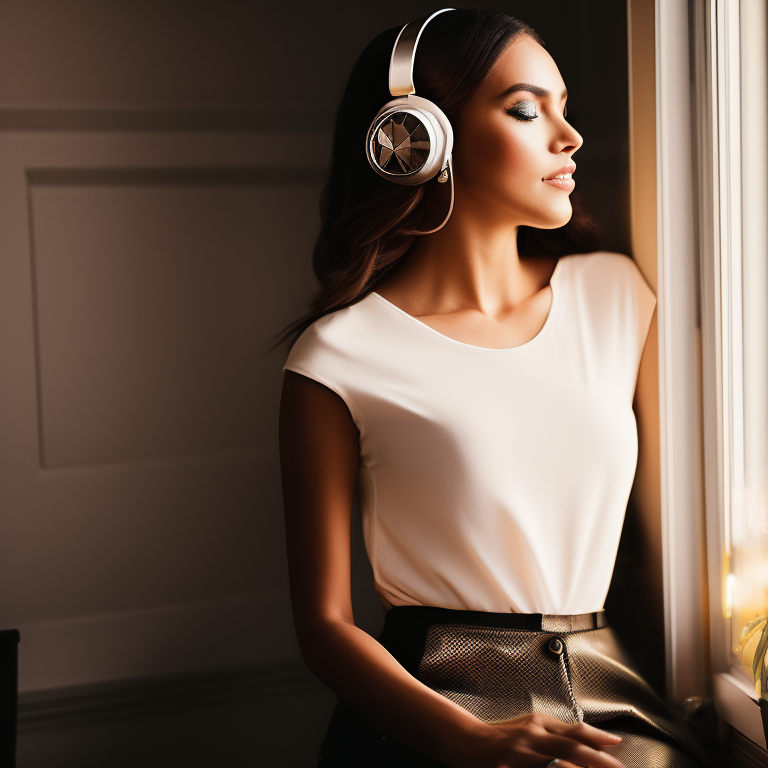

In [24]:
prompt = "photo of young woman sitting by window with headphones, realistic, golden hour, rim lighting"
neg_prompt = "bad anatomy, ugly, deformed, desfigured, distorted face, poorly drawn hands, poorly drawn face, poorly drawn feet"

img = sd21(prompt,
          negative_prompt=neg_prompt,
          generator=torch.Generator("cuda").manual_seed(seed),
          num_inference_steps=35).images[0]
img

  0%|          | 0/35 [00:00<?, ?it/s]

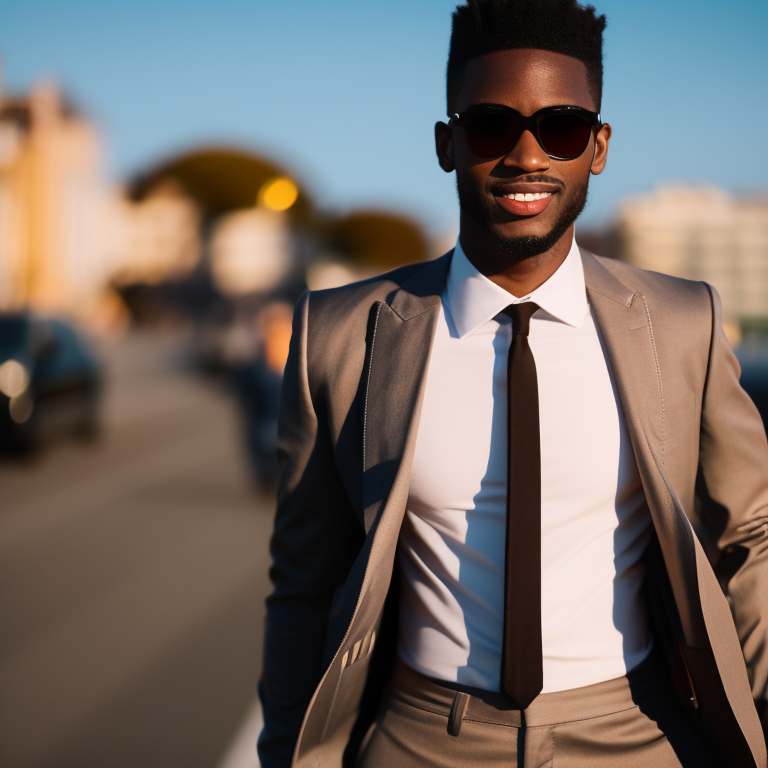

In [25]:
prompt = "a young man in the street, wearing a suit and sunglasses, side light, golden hour"
neg_prompt = "ugly, tiling, closed eyes, poorly drawn hands, poorly drawn feet, poorly drawn face, out of frame, extra limbs, disfigured, deformed, body out of frame, bad anatomy, watermark, signature, cut off, low contrast, underexposed, overexposed, bad art, beginner, amateur, distorted face"

img = sd21(prompt,
          negative_prompt=neg_prompt,
          generator=torch.Generator("cuda").manual_seed(seed),
          num_inference_steps=35).images[0]
img

## Use cases

### Generating arts

  0%|          | 0/35 [00:00<?, ?it/s]

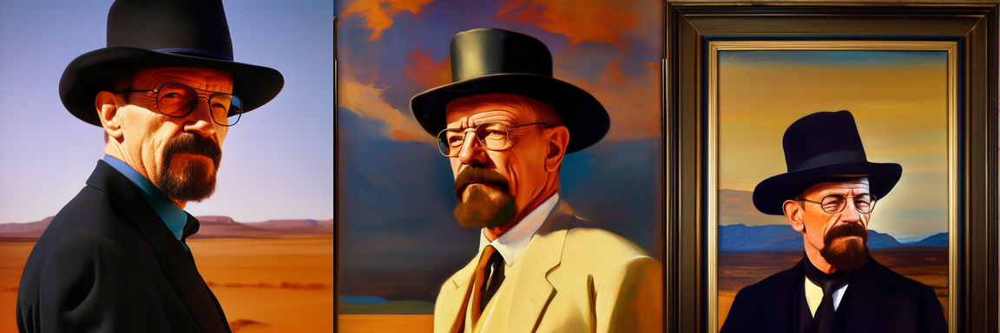

In [26]:
prompt = "oil painting walter white wearing a suit and black hat, by Alphonse Mucha, face portrait, in the desert, realistic, vivid, fantasy, Surrealist"
neg_prompt = "out of frame, out of image, unrealistic, bad anatomy, ugly, deformed, desfigured, distorted face, poorly drawn hands, poorly drawn face, poorly drawn feet"
num_imgs = 3

generator = torch.Generator("cuda").manual_seed(seed)
imgs = sd21(prompt,
             num_images_per_prompt=num_imgs,
             generator=generator,
             negative_prompt = neg_prompt,
             num_inference_steps=35).images

grid = grid_img(imgs, rows=1, cols=num_imgs, scale=0.5)
grid

  0%|          | 0/50 [00:00<?, ?it/s]

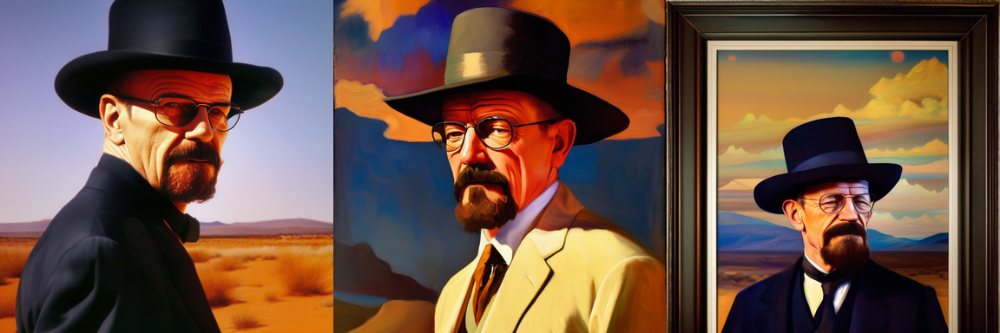

In [27]:
prompt = "oil painting walter white wearing a suit and black hat, by Alphonse Mucha, face portrait, in the desert, realistic, vivid, fantasy, Surrealist"
neg_prompt = "out of frame, out of image, unrealistic, bad anatomy, ugly, deformed, desfigured, distorted face, poorly drawn hands, poorly drawn face, poorly drawn feet"
num_imgs = 3

generator = torch.Generator("cuda").manual_seed(seed)
imgs = sd21(prompt,
             num_images_per_prompt=num_imgs,
             generator=generator,
             negative_prompt = neg_prompt,
             num_inference_steps=50).images

grid = grid_img(imgs, rows=1, cols=num_imgs, scale=0.5)
grid

In [28]:
from diffusers import DDIMScheduler
sd21.scheduler = DDIMScheduler.from_config(sd21.scheduler.config)

In [29]:
from diffusers import EulerAncestralDiscreteScheduler
sd21.scheduler = EulerAncestralDiscreteScheduler.from_config(sd21.scheduler.config)

### Generating photographs


  0%|          | 0/35 [00:00<?, ?it/s]

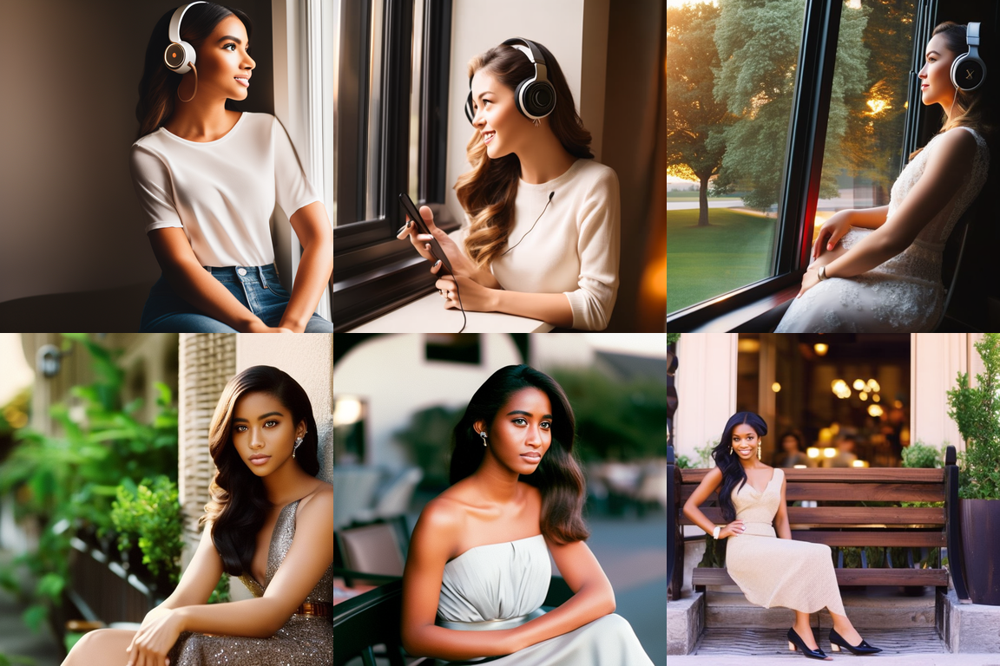

In [30]:
prompt = ["photo of young woman sitting by window with headphones, realistic, golden hour, rim lighting",
          "a young female, highlights in hair, 35mm, medium shot, sitting outside restaurant, brown eyes, wearing a dress, side light"]

neg_prompt = ["ugly, tiling, closed eyes, poorly drawn hands, poorly drawn feet, poorly drawn face, out of frame, extra limbs, disfigured, deformed, body out of frame, bad anatomy, watermark, signature, cut off, low contrast, underexposed, overexposed, bad art, beginner, amateur, distorted face"] * len(prompt)
num_imgs = 3

generator = torch.Generator("cuda").manual_seed(seed)

imgs = sd21(prompt,
             num_images_per_prompt=num_imgs,
             generator=generator,
             negative_prompt = neg_prompt,
             num_inference_steps=35).images

grid = grid_img(imgs, rows=len(prompt), cols=num_imgs, scale=0.5)
grid

### Generating landscapes

  0%|          | 0/35 [00:00<?, ?it/s]

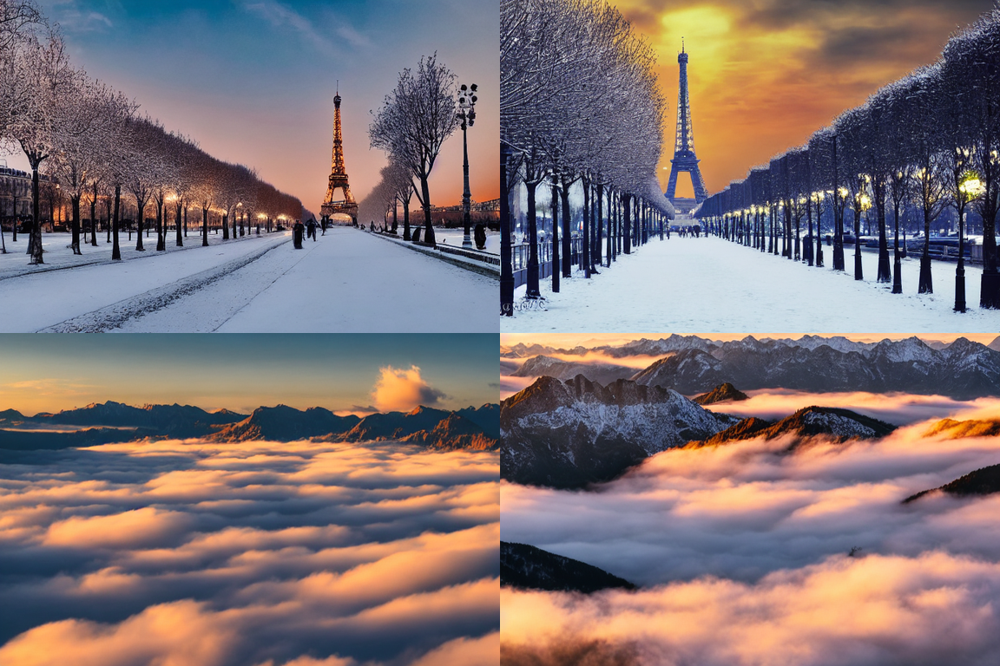

In [31]:
prompt = ["photograph of snow in paris, realistic, landscape, sunset",
          "photograph of a mountain landscape during sunset, above the clouds"]

num_imgs = 2
h, w = 512, 768

generator = torch.Generator("cuda").manual_seed(seed)

imgs = pipe(prompt,
             num_images_per_prompt=num_imgs,
             generator=generator,
             height=h, width=w,
             num_inference_steps=35).images

grid = grid_img(imgs, rows=len(prompt), cols=num_imgs, scale=0.75)
grid

### Generating 3D images


### Generating drawings

  0%|          | 0/50 [00:00<?, ?it/s]

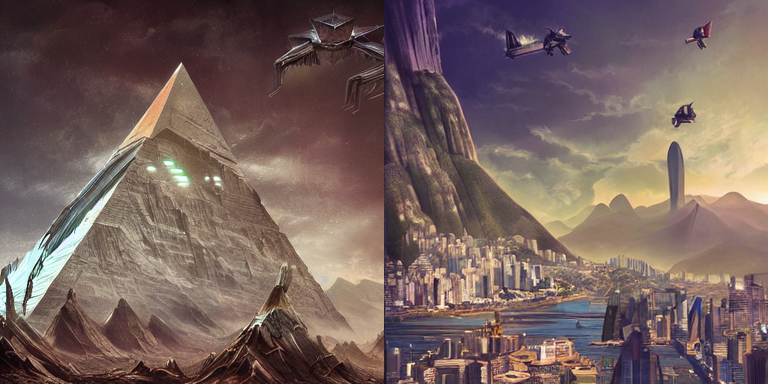

In [44]:
prompt = ["a highly detailed epic cinematic concept art an alien pyramid landscape, art station, landscape, concept art, illustration, highly detailed artwork cinematic, hyper realistic painting",
          "futuristic rio de janeiro, realistic, art station, cinematic, concept art, skyscrapers, landscape, highly detailed artwork"
          ]

generator = torch.Generator("cuda").manual_seed(seed)
imgs = pipe(prompt,
             generator=generator,
             num_inference_steps=50).images

grid = grid_img(imgs, rows=1, cols=len(prompt), scale=0.75)
grid

### Generating architectures

## Improving the results using custom models



### Some models




> **Anything v3.1** (cag/anything-v3-1)

In [46]:
from diffusers import DPMSolverMultistepScheduler

seed = 777
anything = StableDiffusionPipeline.from_pretrained("cag/anything-v3-1", torch_dtype=torch.float16)
anything = anything.to("cuda")
anything.enable_attention_slicing()
anything.scheduler = DPMSolverMultistepScheduler.from_config(anything.scheduler.config)

safety_checker/model.safetensors not found


Fetching 18 files:   0%|          | 0/18 [00:00<?, ?it/s]

> **Protogen** (`darkstorm2150/Protogen_x3.4_Official_Release`)

In [48]:
from diffusers import DPMSolverMultistepScheduler

protogen = StableDiffusionPipeline.from_pretrained("darkstorm2150/Protogen_x3.4_Official_Release", torch_dtype=torch.float16)
protogen = protogen.to("cuda")
protogen.enable_attention_slicing()
protogen.scheduler = DPMSolverMultistepScheduler.from_config(protogen.scheduler.config)

unet/diffusion_pytorch_model.safetensors not found


Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.
The config attributes {'scaling_factor': 0.18215} were passed to AutoencoderKL, but are not expected and will be ignored. Please verify your config.json configuration file.


> **Analog-Diffusion** (wavymulder/Analog-Diffusion)


In [50]:
from diffusers import EulerAncestralDiscreteScheduler

ad = StableDiffusionPipeline.from_pretrained("wavymulder/Analog-Diffusion", torch_dtype=torch.float16)
ad = ad.to("cuda")
ad.enable_attention_slicing()
ad.scheduler = EulerAncestralDiscreteScheduler.from_config(ad.scheduler.config)

unet/diffusion_pytorch_model.safetensors not found


Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.
The config attributes {'scaling_factor': 0.18215} were passed to AutoencoderKL, but are not expected and will be ignored. Please verify your config.json configuration file.


> **DreamShaper** (`jzli/DreamShaper-3.3`)
or, you can use Lykon/DreamShaper instead

In [60]:
from diffusers import EulerAncestralDiscreteScheduler

ds = StableDiffusionPipeline.from_pretrained("jzli/DreamShaper-3.3", torch_dtype=torch.float16)
ds = ds.to("cuda")
ds.enable_attention_slicing()
ds.scheduler = EulerAncestralDiscreteScheduler.from_config(ds.scheduler.config)

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


**CUDA out of memory**
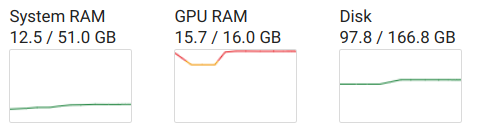
I'm using the Colab Pro plan, I recommend subscribing to the Colab Pro+ plan

In [61]:
prompt = ["analog style orange cat reading a book in space",
          "darth vader in ancient egypt, medium shot",
          "photo of a delorean in the canyons"]

neg_prompt = [""] * 3

generator = torch.Generator("cuda").manual_seed(seed)
ds.safety_checker = None
imgs = ds(prompt,
          negative_prompt=neg_prompt,
          generator=generator,
          num_inference_steps=35).images

grid = grid_img(imgs, rows=1, cols=len(prompt), scale=0.75)
grid

  0%|          | 0/35 [00:00<?, ?it/s]

OutOfMemoryError: ignored

> **Realistic Vision** (`SG161222/Realistic_Vision_V1.4`)

In [ ]:
from diffusers import EulerAncestralDiscreteScheduler

ds = StableDiffusionPipeline.from_pretrained("SG161222/Realistic_Vision_V1.4", torch_dtype=torch.float16)
ds = ds.to("cuda")
ds.enable_attention_slicing()
ds.scheduler = EulerAncestralDiscreteScheduler.from_config(ds.scheduler.config)

In [ ]:
prompt = ["orange cat reading a book in space, 8k uhd, dslr, soft lighting, high quality, film grain, Fujifilm XT3",
          "darth vader in ancient egypt, 8k uhd, dslr, soft lighting, high quality, film grain, Fujifilm XT3",
          "delorean in the canyons, 8k uhd, dslr, soft lighting, high quality, film grain, Fujifilm XT3"]

neg_prompt = [""] * 3

generator = torch.Generator("cuda").manual_seed(seed)
ds.safety_checker = None
imgs = ds(prompt,
          negative_prompt=neg_prompt,
          generator=generator,
          num_inference_steps=35).images

grid = grid_img(imgs, rows=1, cols=len(prompt), scale=0.75)
grid